In [2]:
from IPython.display import Image
from skimage.feature import hog

import skimage
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np


#print (cv2. __version__) 

In [3]:
def ImageMatching(img1, img2, distance_ratio):
    # tao bo trich chon dac trung 
    sift = cv2.SIFT_create(nOctaveLayers=10)
    # trich suat dac trung cua anh
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    # tim su tuong dong giua 2 anh 
    ## tìm các cặp đặc trưng tương đồng giữa 2 ảnh. Có thể sử dụng phương pháp vét cạn BRUTE_FORCE matching hoặc FLANN hỗ trợ so khớp nhanh hơn
    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 100)
    search_params = dict(checks=10000)

    flann = cv2.FlannBasedMatcher(index_params,search_params)

    matches2 = flann.knnMatch(des1,des2,k=2) # trả về 2 features gần nhất từ tập des2

    MIN_MATCH_COUNT=10
    good = []
    distance_ratio = distance_ratio
    for m,n in matches2:
        if m.distance < distance_ratio*n.distance:
        # chỉ giữ lại những ghép cặp ổn định (m.distance: khoảng cách gần nhất, n.distance: khoảng cách gần thứ 2)
            good.append(m)
    
    ## khoanh vùng đối tượng tương ứng được tìm thấy
    if len(good)>MIN_MATCH_COUNT:
        src_pts = np.float32([kp1[m.queryIdx].pt for m in good]).reshape(-1,1,2)
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in good]).reshape(-1,1,2)
        
        # tìm phép biến đổi đồng dạng giữa 2 tập điểm được so khớp
        ### YOUR CODE HERE
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0) 
        ### YOUR CODE HERE
        
        matchesMask = mask.ravel().tolist()
        #h,w,d = img1.shape
        
        # xác định vị trí tương ứng trên ảnh đích của 4 góc trên ảnh nguồn
        
        # pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2) # 4 điểm khoanh vùng trên ảnh nguồn
        # ### YOUR CODE HERE
        # dst = cv2.perspectiveTransform(pts,M) # thực hiện biến đổi để tìm ra vị trí tương ứng trong ảnh được so khớp
        # ### YOUR CODE HERE
        
        # # hiển thị kết quả tương ứng
        # img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)
        # print("Good matches",len(good))
    else:
        #print( "Not enough matches are found - {}/{}".format(len(good), MIN_MATCH_COUNT) )
        matchesMask = None
    ## hiển thị kết quả
    draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                    singlePointColor = None,
                    matchesMask = matchesMask, # draw only inliers
                    flags = 2)
    img12 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)
    return img12 
#print (cv2. _version_) 

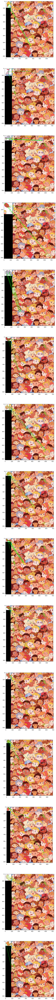

In [4]:
plt.figure(figsize=(300,150))
for i in range(1,16):
    template = cv2.imread('image/tmp'+str(i)+'.jpg')
    img = cv2.imread('image/bt.jpg')
    result = ImageMatching(template,img, 0.9)
    plt.subplot(15,1,i)
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

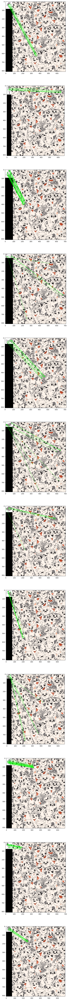

In [5]:
plt.figure(figsize=(240,150))
for i in range(1,13):
    template = cv2.imread('image/tem'+str(i)+'.jpg')
    img = cv2.imread('image/bt2.jpg')
    result = ImageMatching(template,img, 0.9)
    plt.subplot(15,1,i)
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))